# <p style="background-color:green;font-family:newtimeroman;font-size:200%;color:white;text-align:center;border-radius:20px 20px;"><b>Capstone Project-5 (Hand_Written_Digits)</b></p>
![](https://www.techproeducation.com/logo/headerlogo.svg)

<b>Yeniliklerden ilk siz haberdar olmak istiyorsanız lütfen bizi takip etmeyi unutmayın </b>[YouTube](https://www.youtube.com/c/techproeducation) | [Instagram](https://www.instagram.com/techproeducation) | [Facebook](https://www.facebook.com/techproeducation) | [Telegram](https://t.me/joinchat/HH2qRvA-ulh4OWbb) | [Watsapp](https://api.whatsapp.com/send/?phone=%2B15853042959&text&type=phone_number&app_absent=0) | [Linkedin](https://www.linkedin.com/company/techproeducation/mycompany/) |

https://www.researchgate.net/publication/347943261_Handwritten_Digit_Recognition_Using_Machine_Learning

# Hand Written Digits Project

Data reference link : https://datahub.io/machine-learning/pendigits#readme

In [87]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import cufflinks as cf   # !pip install cufflinks

from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)
cf.go_offline()

from sklearn.model_selection import train_test_split, GridSearchCV, cross_validate
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline

from sklearn.metrics import log_loss, recall_score, accuracy_score, precision_score, f1_score
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn.metrics import RocCurveDisplay, roc_auc_score, auc
from sklearn.metrics import roc_curve, average_precision_score, precision_recall_curve
from sklearn.metrics import make_scorer

from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler

import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")
%matplotlib inline
#%matplotlib notebook
plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [88]:
df = pd.read_csv("pendigits_txt.csv")

In [89]:
df.head()

,input1,input2,input3,input4,input5,input6,input7,input8,input9,input10,input11,input12,input13,input14,input15,input16,class
0,47,100,27,81,57,37,26,0,0,23,56,53,100,90,40,98,8
1,0,89,27,100,42,75,29,45,15,15,37,0,69,2,100,6,2
2,0,57,31,68,72,90,100,100,76,75,50,51,28,25,16,0,1
3,0,100,7,92,5,68,19,45,86,34,100,45,74,23,67,0,4
4,0,67,49,83,100,100,81,80,60,60,40,40,33,20,47,0,1


# Exploratory Data Analysis and Visualization

In [90]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10992 entries, 0 to 10991
Data columns (total 17 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   input1   10992 non-null  int64
 1   input2   10992 non-null  int64
 2   input3   10992 non-null  int64
 3   input4   10992 non-null  int64
 4   input5   10992 non-null  int64
 5   input6   10992 non-null  int64
 6   input7   10992 non-null  int64
 7   input8   10992 non-null  int64
 8   input9   10992 non-null  int64
 9   input10  10992 non-null  int64
 10  input11  10992 non-null  int64
 11  input12  10992 non-null  int64
 12  input13  10992 non-null  int64
 13  input14  10992 non-null  int64
 14  input15  10992 non-null  int64
 15  input16  10992 non-null  int64
 16  class    10992 non-null  int64
dtypes: int64(17)
memory usage: 1.4 MB


In [91]:
df.shape

(10992, 17)

In [92]:
df.isnull().sum()

input1     0
input2     0
input3     0
input4     0
input5     0
input6     0
input7     0
input8     0
input9     0
input10    0
input11    0
input12    0
input13    0
input14    0
input15    0
input16    0
class      0
dtype: int64

In [93]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
input1,10992.000,38.814,34.258,0.000,6.000,32.000,65.000,100.000
input2,10992.000,85.120,16.219,0.000,76.000,89.000,100.000,100.000
input3,10992.000,40.606,26.343,0.000,20.000,40.000,58.000,100.000
input4,10992.000,83.774,19.164,0.000,72.000,91.000,100.000,100.000
input5,10992.000,49.770,34.101,0.000,18.000,53.000,78.000,100.000
input6,10992.000,65.573,26.997,0.000,49.000,71.000,86.000,100.000
input7,10992.000,51.220,30.577,0.000,28.000,53.500,74.000,100.000
input8,10992.000,44.499,29.906,0.000,23.000,43.000,64.000,100.000
input9,10992.000,56.869,34.136,0.000,29.000,60.000,89.000,100.000
input10,10992.000,33.696,27.252,0.000,7.000,33.000,54.000,100.000


In [94]:
species_count = df['class'].value_counts().reset_index()
species_count.columns = ['class', 'count']

fig = px.bar(species_count, x='class', y='count', text='count', color='class')

fig.update_traces(texttemplate='%{text}', textposition='outside')

# ax = sns.countplot(x="class", data=df)
# ax.bar_label(ax.containers[0]);

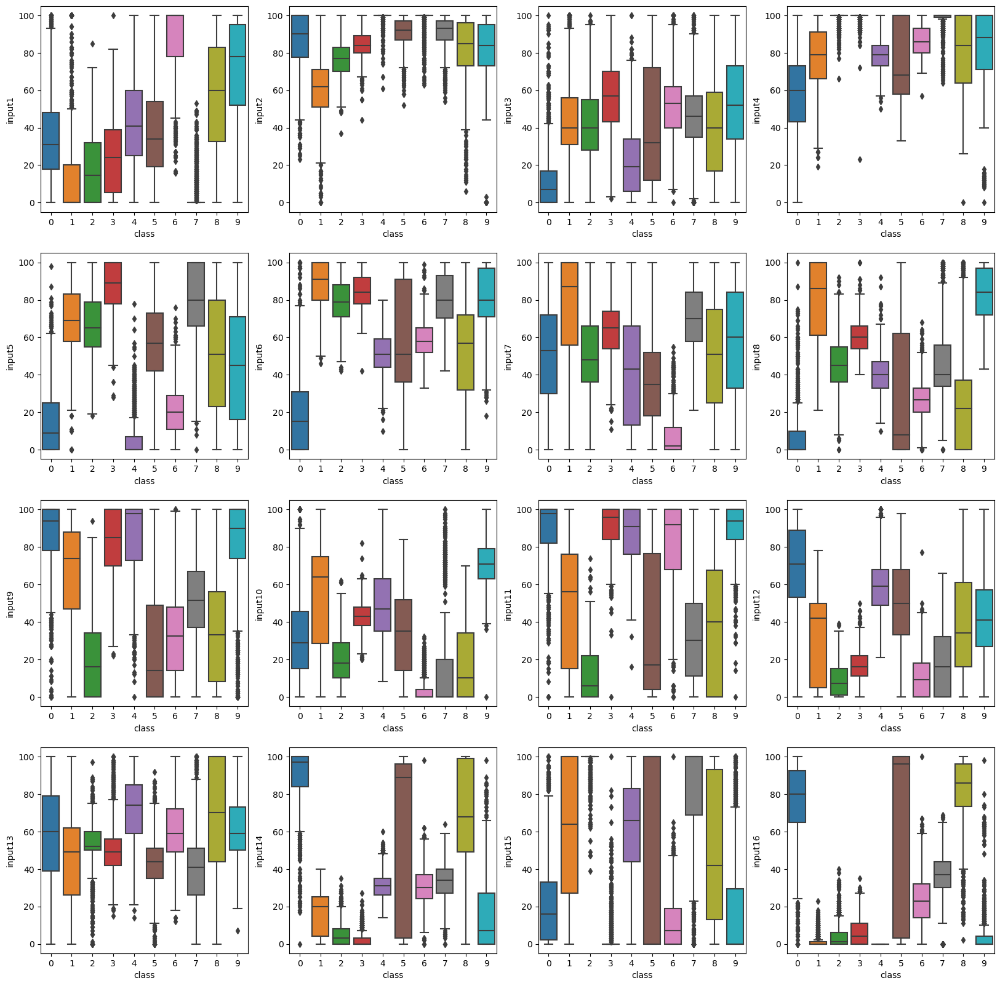

In [95]:
index = 0
plt.figure(figsize=(20,20))
for feature in df.columns:
    if feature != "class":
        index += 1
        plt.subplot(4,4,index)
        sns.boxplot(x='class',y=feature,data=df)
plt.show()

In [152]:
cf.go_offline()
df.iloc[:,1:].iplot(kind="box")

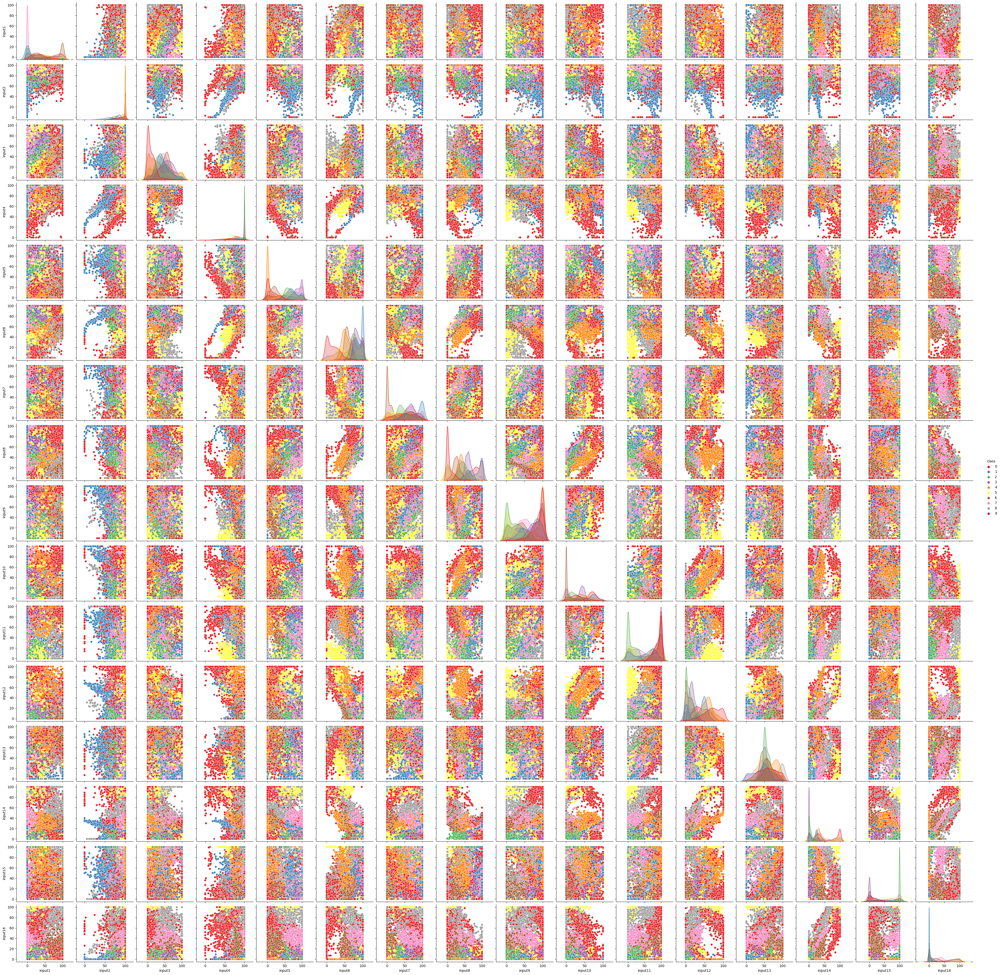

In [153]:
sns.pairplot(df, hue='class', palette="Set1")

In [154]:
 df.corr()

,input1,input2,input3,input4,input5,input6,input7,input8,input9,input10,input11,input12,input13,input14,input15,input16,class
input1,1.000,0.348,0.281,0.120,-0.440,-0.104,-0.367,-0.102,-0.038,-0.103,0.189,-0.106,0.135,-0.023,-0.358,0.034,0.352
input2,0.348,1.000,-0.080,0.214,-0.311,-0.255,-0.320,-0.383,-0.081,-0.307,0.145,-0.023,0.134,0.124,-0.135,0.128,0.232
input3,0.281,-0.080,1.000,0.442,0.416,0.457,-0.190,0.296,-0.144,-0.037,-0.023,-0.463,-0.163,-0.473,-0.179,-0.315,0.243
input4,0.120,0.214,0.442,1.000,0.195,0.676,-0.036,0.269,-0.156,-0.282,-0.181,-0.733,-0.089,-0.648,0.114,-0.385,0.184
input5,-0.440,-0.311,0.416,0.195,1.000,0.465,0.428,0.356,-0.224,0.049,-0.323,-0.308,-0.340,-0.281,0.053,-0.125,0.040
input6,-0.104,-0.255,0.457,0.676,0.465,1.000,0.186,0.780,-0.036,0.156,-0.150,-0.633,-0.181,-0.795,0.094,-0.598,0.154
input7,-0.367,-0.320,-0.190,-0.036,0.428,0.186,1.000,0.380,0.437,0.355,-0.162,0.100,-0.372,-0.081,0.035,-0.103,-0.123
input8,-0.102,-0.383,0.296,0.269,0.356,0.780,0.380,1.000,0.295,0.651,0.114,-0.237,-0.129,-0.720,-0.134,-0.711,0.109
input9,-0.038,-0.081,-0.144,-0.156,-0.224,-0.036,0.437,0.295,1.000,0.533,0.604,0.292,-0.067,-0.097,-0.391,-0.268,-0.170
input10,-0.103,-0.307,-0.037,-0.282,0.049,0.156,0.355,0.651,0.533,1.000,0.390,0.475,0.024,-0.215,-0.336,-0.454,-0.045


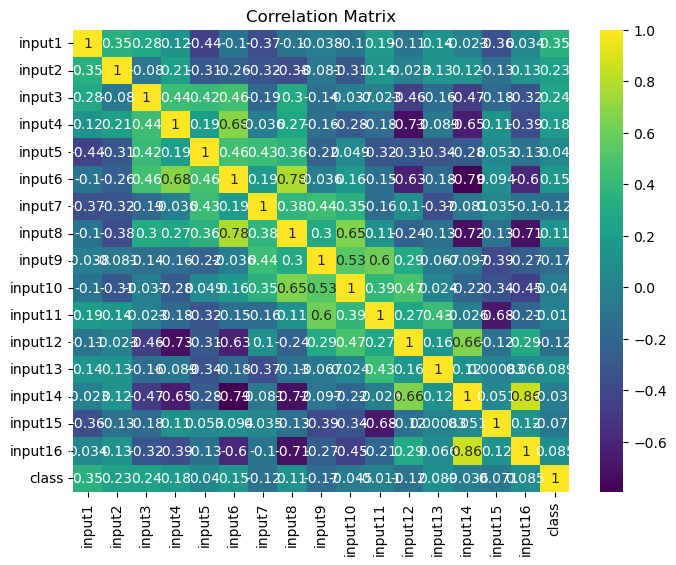

In [155]:
plt.figure(figsize=(8,6))
sns.heatmap(df.corr(),annot=True, cmap='viridis')
plt.title("Correlation Matrix")

plt.show()

In [99]:
df['class'].value_counts()

2    1144
4    1144
1    1143
0    1143
7    1142
6    1056
8    1055
5    1055
9    1055
3    1055
Name: class, dtype: int64

In [100]:
df['class'].value_counts(normalize=True)

2   0.104
4   0.104
1   0.104
0   0.104
7   0.104
6   0.096
8   0.096
5   0.096
9   0.096
3   0.096
Name: class, dtype: float64

## Train | Test Split

In [101]:
X = df.drop("class", axis=1)
y = df["class"]

In [102]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

# Support Vector Machine (SVM) Classifier

In [157]:
pipe_svm = Pipeline(steps=[("scaler", StandardScaler()), ("svm_model", SVC(random_state=101))])
pipe_svm.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('svm_model', SVC(random_state=101))])

In [158]:
pipe_svm.predict(X_test)

array([7, 5, 2, ..., 5, 1, 2])

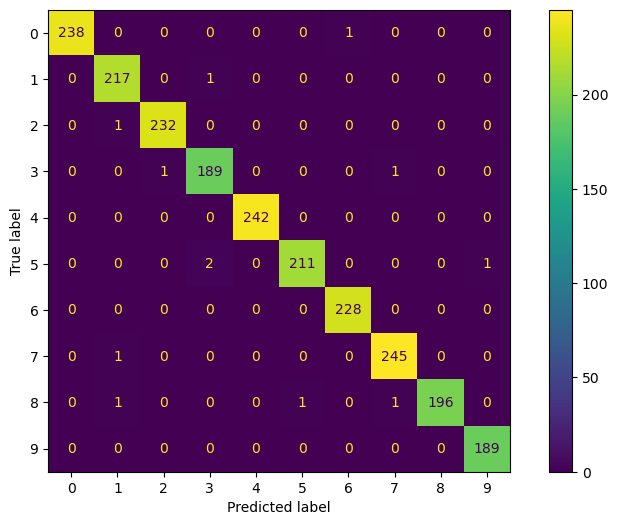

In [160]:
ConfusionMatrixDisplay.from_estimator(pipe_svm, X_test, y_test, cmap="viridis");

In [105]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))

In [106]:
eval_metric(pipe_svm, X_train, y_train, X_test, y_test)

Test_Set
[[238   0   0   0   0   0   1   0   0   0]
 [  0 217   0   1   0   0   0   0   0   0]
 [  0   1 232   0   0   0   0   0   0   0]
 [  0   0   1 189   0   0   0   1   0   0]
 [  0   0   0   0 242   0   0   0   0   0]
 [  0   0   0   2   0 211   0   0   0   1]
 [  0   0   0   0   0   0 228   0   0   0]
 [  0   1   0   0   0   0   0 245   0   0]
 [  0   1   0   0   0   1   0   1 196   0]
 [  0   0   0   0   0   0   0   0   0 189]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       239
           1       0.99      1.00      0.99       218
           2       1.00      1.00      1.00       233
           3       0.98      0.99      0.99       191
           4       1.00      1.00      1.00       242
           5       1.00      0.99      0.99       214
           6       1.00      1.00      1.00       228
           7       0.99      1.00      0.99       246
           8       1.00      0.98      0.99       199
           9       

In [107]:
X_train

,input1,input2,input3,input4,input5,input6,input7,input8,input9,input10,input11,input12,input13,input14,input15,input16
3683,61,91,29,100,47,74,74,85,100,51,97,12,50,0,0,11
10729,7,95,47,100,68,69,50,34,27,0,0,19,44,31,100,35
6198,3,83,47,67,51,25,0,0,11,37,65,69,100,100,21,92
6023,100,100,54,99,16,79,0,51,48,51,76,27,47,1,1,0
9555,23,88,0,47,20,7,66,0,100,29,91,76,52,100,12,78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
599,19,81,53,100,68,79,49,52,95,38,100,9,50,0,0,7
5695,49,92,58,48,66,4,0,0,39,36,100,65,92,100,25,88
8006,72,89,88,80,71,100,72,85,100,57,87,18,41,0,0,21
1361,100,75,60,100,0,85,14,53,75,68,88,78,73,39,71,0


## SVM - Cross Validation

In [108]:
from sklearn.model_selection import cross_validate
from sklearn.metrics import make_scorer, precision_score, recall_score, f1_score


scores = cross_validate(pipe_svm, X_train, y_train, scoring={"accuracy": "accuracy",  
                                                             "precision":make_scorer(precision_score, average="macro"), 
                                                               "recall": make_scorer(recall_score, average="macro"),
                                                               "f1":make_scorer(f1_score, average="macro")}, cv=10)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy    0.994
test_precision   0.994
test_recall      0.994
test_f1          0.994
dtype: float64

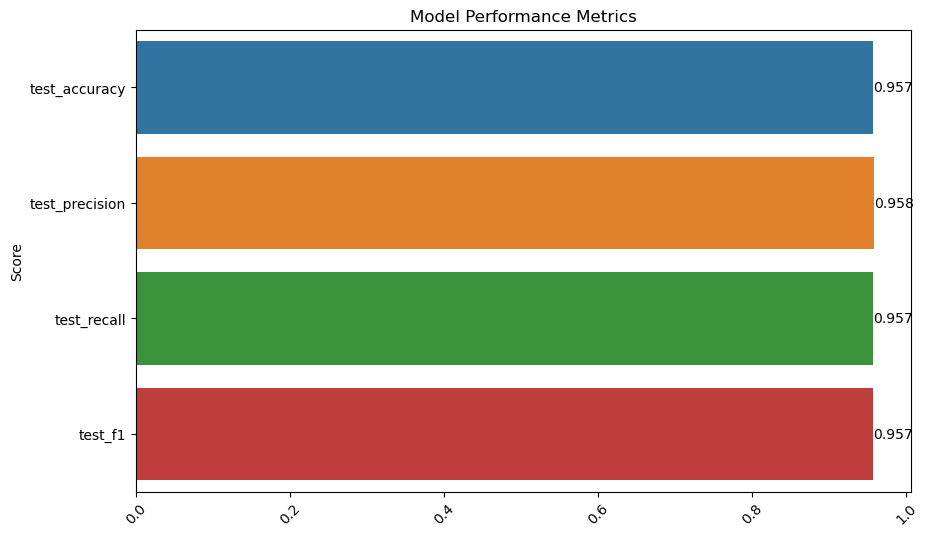

In [175]:
mean_scores = pd.DataFrame(scores).mean()[2:]

plt.figure(figsize=(10, 6))
ax = sns.barplot(y=mean_scores.index, x=mean_scores.values)
ax.bar_label(ax.containers[0], fmt='%.3f') 
plt.xticks(rotation=45)
plt.ylabel('Score')
plt.title('Model Performance Metrics');

In [109]:
pipe_svm.get_params()

{'memory': None,
 'steps': [('scaler', StandardScaler()), ('svm_model', SVC(random_state=101))],
 'verbose': False,
 'scaler': StandardScaler(),
 'svm_model': SVC(random_state=101),
 'scaler__copy': True,
 'scaler__with_mean': True,
 'scaler__with_std': True,
 'svm_model__C': 1.0,
 'svm_model__break_ties': False,
 'svm_model__cache_size': 200,
 'svm_model__class_weight': None,
 'svm_model__coef0': 0.0,
 'svm_model__decision_function_shape': 'ovr',
 'svm_model__degree': 3,
 'svm_model__gamma': 'scale',
 'svm_model__kernel': 'rbf',
 'svm_model__max_iter': -1,
 'svm_model__probability': False,
 'svm_model__random_state': 101,
 'svm_model__shrinking': True,
 'svm_model__tol': 0.001,
 'svm_model__verbose': False}

## SVM - Grid Search

In [180]:
param_grid = {"SVC__C":[0.1, 1.0, 10],
             "SVC__gamma":["scale", "auto", 0.2],
             "SVC__kernel":["rbf", "linear", "poly"],
             "SVC__degree":[3,4]}

In [181]:
pipe_model = Pipeline(steps=([("scaler", StandardScaler()), ("SVC", SVC(random_state = 101))]))

svm_grid = GridSearchCV(pipe_model, param_grid, scoring ="accuracy", cv=5)

In [182]:
svm_grid.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('SVC', SVC(random_state=101))]),
             param_grid={'SVC__C': [0.1, 1.0, 10], 'SVC__degree': [3, 4],
                         'SVC__gamma': ['scale', 'auto', 0.2],
                         'SVC__kernel': ['rbf', 'linear', 'poly']},
             scoring='accuracy')

In [185]:
svm_grid.best_score_

0.9960198194107857

In [186]:
svm_grid.best_params_

{'SVC__C': 10, 'SVC__degree': 3, 'SVC__gamma': 'scale', 'SVC__kernel': 'rbf'}

In [187]:
eval_metric(svm_grid, X_train, y_train, X_test, y_test)

Test_Set
[[238   0   0   0   0   0   1   0   0   0]
 [  0 216   0   1   0   0   0   1   0   0]
 [  0   1 232   0   0   0   0   0   0   0]
 [  0   0   1 189   0   0   0   1   0   0]
 [  0   0   0   0 242   0   0   0   0   0]
 [  0   0   0   1   0 212   0   0   0   1]
 [  0   0   0   0   0   0 228   0   0   0]
 [  0   0   0   0   0   0   0 246   0   0]
 [  0   1   0   0   0   1   0   0 197   0]
 [  0   0   0   0   0   0   0   0   0 189]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       239
           1       0.99      0.99      0.99       218
           2       1.00      1.00      1.00       233
           3       0.99      0.99      0.99       191
           4       1.00      1.00      1.00       242
           5       1.00      0.99      0.99       214
           6       1.00      1.00      1.00       228
           7       0.99      1.00      1.00       246
           8       1.00      0.99      0.99       199
           9       

In [188]:
pipe_svm = Pipeline(steps=([("scaler", StandardScaler()), ("SVC", SVC(random_state = 101))]))

scores = cross_validate(pipe_svm, X_train, y_train, scoring={"accuracy": "accuracy", 
                                                               "precision": make_scorer(precision_score, average="macro"), 
                                                               "recall": make_scorer(recall_score, average="macro"),
                                                               "f1": make_scorer(f1_score, average="macro")}, cv=10)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy    0.994
test_precision   0.994
test_recall      0.994
test_f1          0.994
dtype: float64

# Decision Tree (DT) Classifier

In [276]:
pipe_dt = Pipeline(steps=[("dt_model", DecisionTreeClassifier(random_state=101))])
pipe_dt.fit(X_train, y_train)

Pipeline(steps=[('dt_model', DecisionTreeClassifier(random_state=101))])

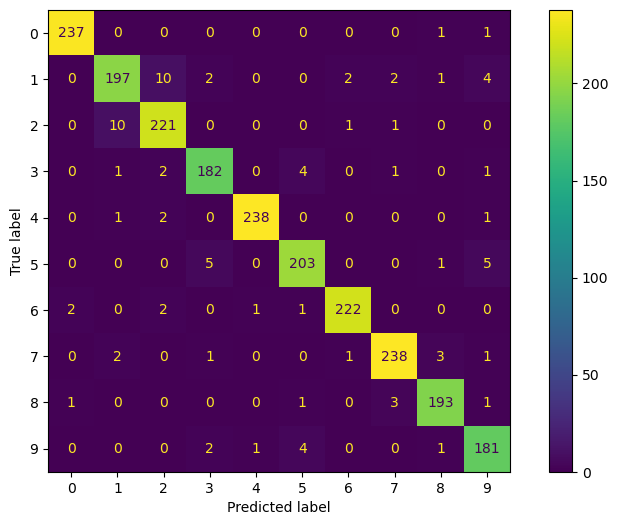

In [277]:
ConfusionMatrixDisplay.from_estimator(pipe_dt, X_test, y_test, cmap="viridis");

In [278]:
eval_metric(pipe_dt, X_train, y_train, X_test, y_test)

Test_Set
[[237   0   0   0   0   0   0   0   1   1]
 [  0 197  10   2   0   0   2   2   1   4]
 [  0  10 221   0   0   0   1   1   0   0]
 [  0   1   2 182   0   4   0   1   0   1]
 [  0   1   2   0 238   0   0   0   0   1]
 [  0   0   0   5   0 203   0   0   1   5]
 [  2   0   2   0   1   1 222   0   0   0]
 [  0   2   0   1   0   0   1 238   3   1]
 [  1   0   0   0   0   1   0   3 193   1]
 [  0   0   0   2   1   4   0   0   1 181]]
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       239
           1       0.93      0.90      0.92       218
           2       0.93      0.95      0.94       233
           3       0.95      0.95      0.95       191
           4       0.99      0.98      0.99       242
           5       0.95      0.95      0.95       214
           6       0.98      0.97      0.98       228
           7       0.97      0.97      0.97       246
           8       0.96      0.97      0.97       199
           9       

In [279]:
pipe_dt["dt_model"].feature_importances_


array([0.07416588, 0.05201514, 0.02182553, 0.09988412, 0.10159865,
       0.02049875, 0.02563586, 0.01626747, 0.02134432, 0.1269361 ,
       0.13610279, 0.01444132, 0.04073608, 0.02787464, 0.05371491,
       0.16695844])

In [280]:
df_fi = pd.DataFrame(data = pipe_dt["dt_model"].feature_importances_, index=X_train.columns, #index=X.columns
                      columns = ["Feature Importance"])
df_fi = df_fi.sort_values("Feature Importance", ascending=False)

df_fi

,Feature Importance
input16,0.167
input11,0.136
input10,0.127
input5,0.102
input4,0.100
input1,0.074
input15,0.054
input2,0.052
input13,0.041
input14,0.028


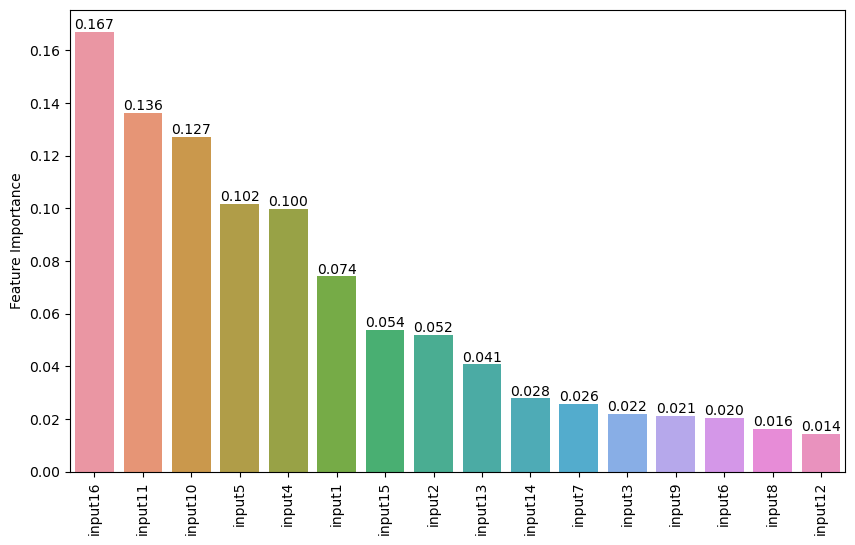

In [281]:
ax =sns.barplot(x = df_fi.index, y = 'Feature Importance', data = df_fi)
ax.bar_label(ax.containers[0],fmt="%.3f");
plt.xticks(rotation = 90)
plt.show();

## Decision Tree - Cross Validation

In [265]:
pipe_dt = Pipeline(steps=[("dt_model", DecisionTreeClassifier(random_state=101))])
scores = cross_validate(pipe_dt, X_train, y_train, scoring={"accuracy": "accuracy",  
                                                             "precision":make_scorer(precision_score, average="macro"), 
                                                               "recall": make_scorer(recall_score, average="macro"),
                                                               "f1":make_scorer(f1_score, average="macro")}, cv=10)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy    0.957
test_precision   0.958
test_recall      0.957
test_f1          0.957
dtype: float64

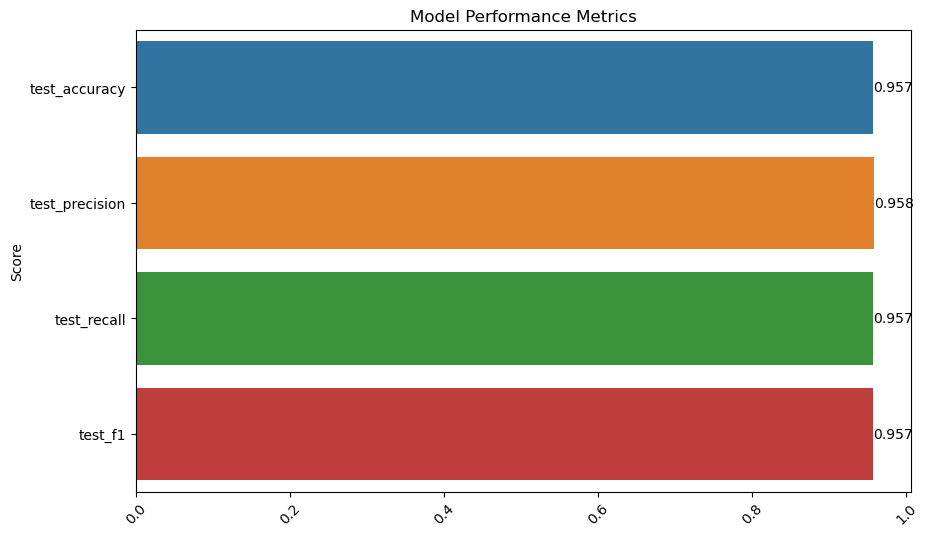

In [266]:
mean_scores = pd.DataFrame(scores).mean()[2:]

plt.figure(figsize=(10, 6))
ax = sns.barplot(y=mean_scores.index, x=mean_scores.values)
ax.bar_label(ax.containers[0], fmt='%.3f') 
plt.xticks(rotation=45)
plt.ylabel('Score')
plt.title('Model Performance Metrics');

In [267]:
pipe_dt.get_params()

{'memory': None,
 'steps': [('dt_model', DecisionTreeClassifier(random_state=101))],
 'verbose': False,
 'dt_model': DecisionTreeClassifier(random_state=101),
 'dt_model__ccp_alpha': 0.0,
 'dt_model__class_weight': None,
 'dt_model__criterion': 'gini',
 'dt_model__max_depth': None,
 'dt_model__max_features': None,
 'dt_model__max_leaf_nodes': None,
 'dt_model__min_impurity_decrease': 0.0,
 'dt_model__min_samples_leaf': 1,
 'dt_model__min_samples_split': 2,
 'dt_model__min_weight_fraction_leaf': 0.0,
 'dt_model__random_state': 101,
 'dt_model__splitter': 'best'}

## Decision Tree - Grid Search

In [268]:
param_grid = {"DT_model__splitter":["best", "random"],
              "DT_model__max_features":[None, "auto", "log2", 3, 6],
              "DT_model__max_depth": [None, 2, 3, 4],
              "DT_model__min_samples_leaf": [1, 2, 3, 4, 5, 6,7],
              "DT_model__min_samples_split": [2, 3, 5, 6, 7,8,9]}

In [269]:
pipe_dt = Pipeline(steps=[("DT_model", DecisionTreeClassifier(random_state=101))])

dt_grid = GridSearchCV(pipe_dt, param_grid, scoring ="accuracy", cv=10)

In [270]:
dt_grid.fit(X_train, y_train)


GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('DT_model',
                                        DecisionTreeClassifier(random_state=101))]),
             param_grid={'DT_model__max_depth': [None, 2, 3, 4],
                         'DT_model__max_features': [None, 'auto', 'log2', 3, 6],
                         'DT_model__min_samples_leaf': [1, 2, 3, 4, 5, 6, 7],
                         'DT_model__min_samples_split': [2, 3, 5, 6, 7, 8, 9],
                         'DT_model__splitter': ['best', 'random']},
             scoring='accuracy')

In [271]:
dt_grid.best_params_

{'DT_model__max_depth': None,
 'DT_model__max_features': None,
 'DT_model__min_samples_leaf': 1,
 'DT_model__min_samples_split': 2,
 'DT_model__splitter': 'random'}

In [272]:
dt_grid.best_score_

0.9591713207156893

In [273]:
eval_metric(dt_grid, X_train, y_train, X_test, y_test)

Test_Set
[[238   0   0   0   0   0   1   0   0   0]
 [  0 199   8   3   1   0   0   5   0   2]
 [  0  11 217   0   2   0   1   2   0   0]
 [  0   2   1 179   0   7   0   1   0   1]
 [  1   0   0   0 236   1   2   0   0   2]
 [  0   2   0   3   0 201   4   0   1   3]
 [  1   0   1   0   1   0 222   0   3   0]
 [  0   4   1   1   0   0   0 239   1   0]
 [  3   0   0   0   0   8   0   1 186   1]
 [  0   4   0   2   5   2   0   1   0 175]]
              precision    recall  f1-score   support

           0       0.98      1.00      0.99       239
           1       0.90      0.91      0.90       218
           2       0.95      0.93      0.94       233
           3       0.95      0.94      0.94       191
           4       0.96      0.98      0.97       242
           5       0.92      0.94      0.93       214
           6       0.97      0.97      0.97       228
           7       0.96      0.97      0.97       246
           8       0.97      0.93      0.95       199
           9       

# Random Forest Classifier

In [283]:
pipe_RF = Pipeline(steps=[("RF_model", RandomForestClassifier(random_state=101))])

pipe_RF.fit(X_train, y_train)

Pipeline(steps=[('RF_model', RandomForestClassifier(random_state=101))])

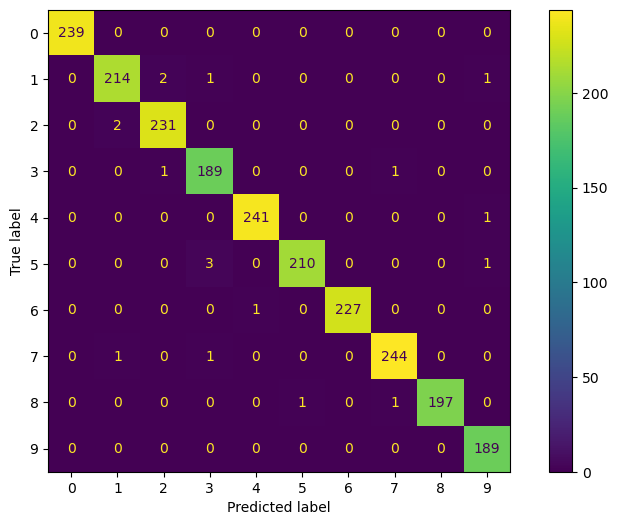

In [284]:
ConfusionMatrixDisplay.from_estimator(pipe_RF, X_test, y_test, cmap="viridis");

In [285]:
eval_metric(pipe_RF, X_train, y_train, X_test, y_test)

Test_Set
[[239   0   0   0   0   0   0   0   0   0]
 [  0 214   2   1   0   0   0   0   0   1]
 [  0   2 231   0   0   0   0   0   0   0]
 [  0   0   1 189   0   0   0   1   0   0]
 [  0   0   0   0 241   0   0   0   0   1]
 [  0   0   0   3   0 210   0   0   0   1]
 [  0   0   0   0   1   0 227   0   0   0]
 [  0   1   0   1   0   0   0 244   0   0]
 [  0   0   0   0   0   1   0   1 197   0]
 [  0   0   0   0   0   0   0   0   0 189]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       239
           1       0.99      0.98      0.98       218
           2       0.99      0.99      0.99       233
           3       0.97      0.99      0.98       191
           4       1.00      1.00      1.00       242
           5       1.00      0.98      0.99       214
           6       1.00      1.00      1.00       228
           7       0.99      0.99      0.99       246
           8       1.00      0.99      0.99       199
           9       

In [286]:
pipe_RF["RF_model"].feature_importances_

array([0.06309402, 0.051331  , 0.02620653, 0.04792223, 0.06843433,
       0.05297122, 0.04589892, 0.0667584 , 0.06894337, 0.07148209,
       0.07291534, 0.05378923, 0.03317017, 0.09343546, 0.07083078,
       0.11281691])

In [287]:
df_fi = pd.DataFrame(data = pipe_RF["RF_model"].feature_importances_, index=X_train.columns, #index=X.columns
                      columns = ["Feature Importance"])
df_fi = df_fi.sort_values("Feature Importance", ascending=False)

df_fi

,Feature Importance
input16,0.113
input14,0.093
input11,0.073
input10,0.071
input15,0.071
input9,0.069
input5,0.068
input8,0.067
input1,0.063
input12,0.054


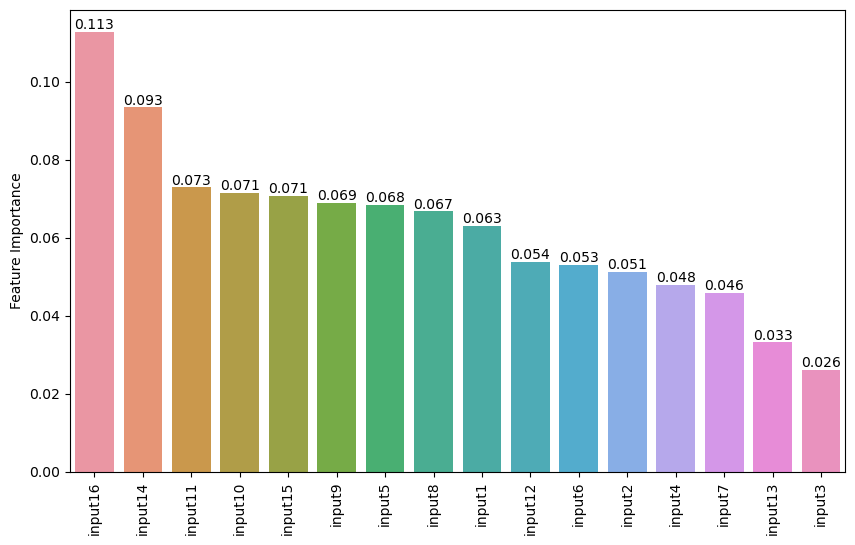

In [288]:
ax =sns.barplot(x = df_fi.index, y = 'Feature Importance', data = df_fi)
ax.bar_label(ax.containers[0],fmt="%.3f");
plt.xticks(rotation = 90)
plt.show();

## Random Forest - Cross Validation

In [228]:
pipe_RF = Pipeline(steps=[("RF_model", RandomForestClassifier(random_state=101))])
scores = cross_validate(pipe_RF, X_train, y_train, scoring={"accuracy": "accuracy",  
                                                             "precision":make_scorer(precision_score, average="macro"), 
                                                               "recall": make_scorer(recall_score, average="macro"),
                                                               "f1":make_scorer(f1_score, average="macro")}, cv=10)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy    0.990
test_precision   0.991
test_recall      0.991
test_f1          0.991
dtype: float64

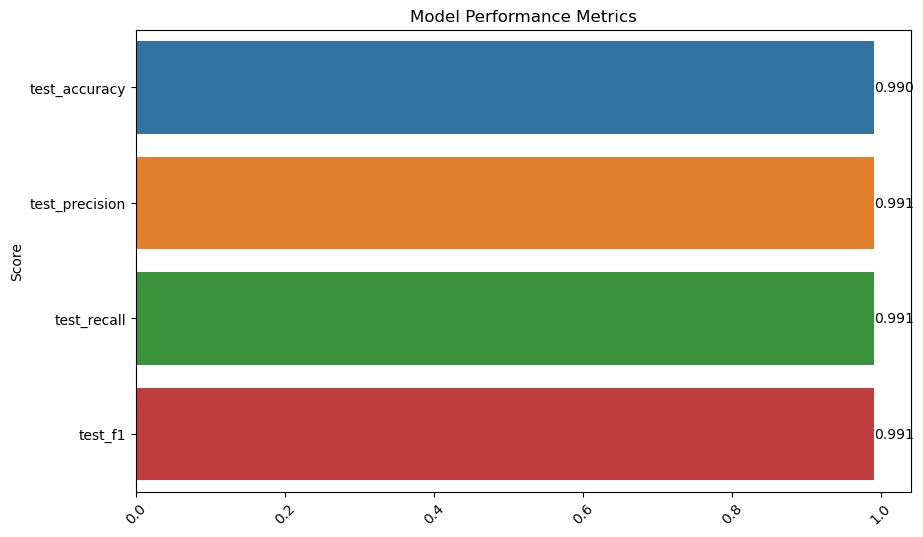

In [229]:
mean_scores = pd.DataFrame(scores).mean()[2:]

plt.figure(figsize=(10, 6))
ax = sns.barplot(y=mean_scores.index, x=mean_scores.values)
ax.bar_label(ax.containers[0], fmt='%.3f') 
plt.xticks(rotation=45)
plt.ylabel('Score')
plt.title('Model Performance Metrics');

In [230]:
pipe_RF.get_params()

{'memory': None,
 'steps': [('RF_model', RandomForestClassifier(random_state=101))],
 'verbose': False,
 'RF_model': RandomForestClassifier(random_state=101),
 'RF_model__bootstrap': True,
 'RF_model__ccp_alpha': 0.0,
 'RF_model__class_weight': None,
 'RF_model__criterion': 'gini',
 'RF_model__max_depth': None,
 'RF_model__max_features': 'sqrt',
 'RF_model__max_leaf_nodes': None,
 'RF_model__max_samples': None,
 'RF_model__min_impurity_decrease': 0.0,
 'RF_model__min_samples_leaf': 1,
 'RF_model__min_samples_split': 2,
 'RF_model__min_weight_fraction_leaf': 0.0,
 'RF_model__n_estimators': 100,
 'RF_model__n_jobs': None,
 'RF_model__oob_score': False,
 'RF_model__random_state': 101,
 'RF_model__verbose': 0,
 'RF_model__warm_start': False}

## Random Forest - Grid Search

In [231]:
param_grid = {'RF_model__n_estimators':[64, 128],
             'RF_model__max_features':[4, 'sqrt'],
             'RF_model__max_depth':[2, 3, 4],
             'RF_model__min_samples_split':[2,4],
             'RF_model__min_samples_leaf': [2,3,4],
             'RF_model__max_samples':[0.8, 1]}

In [232]:
pipe_RF = Pipeline(steps=[("RF_model", RandomForestClassifier(random_state=101))])

RF_grid = GridSearchCV(pipe_RF, param_grid, scoring ="accuracy", cv=5)

In [233]:
RF_grid.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('RF_model',
                                        RandomForestClassifier(random_state=101))]),
             param_grid={'RF_model__max_depth': [2, 3, 4],
                         'RF_model__max_features': [4, 'sqrt'],
                         'RF_model__max_samples': [0.8, 1],
                         'RF_model__min_samples_leaf': [2, 3, 4],
                         'RF_model__min_samples_split': [2, 4],
                         'RF_model__n_estimators': [64, 128]},
             scoring='accuracy')

In [134]:
eval_metric(RF_grid, X_train, y_train, X_test, y_test)

Test_Set
[[233   0   0   0   0   0   1   0   5   0]
 [  0 159  42  14   0   0   1   0   0   2]
 [  0   7 222   1   0   0   1   2   0   0]
 [  0   2   1 187   0   0   0   0   0   1]
 [  0   1   0   0 237   0   1   0   0   3]
 [  0   0   1  41   0 123   2   0   2  45]
 [  2   0   0   1   4   0 216   5   0   0]
 [  0  23   1   2   0   1   1 203   3  12]
 [  1   4   0   3   0   1   0  10 177   3]
 [  7  10   0   2   3   0   0   0   0 167]]
              precision    recall  f1-score   support

           0       0.96      0.97      0.97       239
           1       0.77      0.73      0.75       218
           2       0.83      0.95      0.89       233
           3       0.75      0.98      0.85       191
           4       0.97      0.98      0.98       242
           5       0.98      0.57      0.73       214
           6       0.97      0.95      0.96       228
           7       0.92      0.83      0.87       246
           8       0.95      0.89      0.92       199
           9       

In [135]:
RF_grid.best_score_

0.8810419484128754

In [136]:
RF_grid.best_params_

{'RF_model__max_depth': 4,
 'RF_model__max_features': 4,
 'RF_model__max_samples': 0.8,
 'RF_model__min_samples_leaf': 2,
 'RF_model__min_samples_split': 2,
 'RF_model__n_estimators': 128}

# Choose the Best Model

**==> In this balanced dataset, we compared the accuracy scores of SVM, Decision Tree, and Random Forest models through cross-validation (CV) and grid search. After evaluating the models, we found that the SVM model achieved the highest accuracy score. Therefore, we conclude that the SVM model is the most suitable choice for this dataset.**

In [138]:
Final_model = Pipeline(steps=([("scaler", StandardScaler()), ("SVC", SVC(random_state = 101))]))
Final_model.fit(X,y)

Pipeline(steps=[('scaler', StandardScaler()), ('SVC', SVC(random_state=101))])

# Model Prediction

In [147]:
samples = df.head(10)

In [148]:
samples = samples.drop("class", axis=1)

In [149]:
Final_model.predict(samples)

array([8, 2, 1, 4, 1, 6, 4, 0, 5, 0])

In [150]:
compare = df.head(10)

In [151]:
compare["prediction"] = Final_model.predict(samples)
compare

,input1,input2,input3,input4,input5,input6,input7,input8,input9,input10,input11,input12,input13,input14,input15,input16,class,prediction
0,47,100,27,81,57,37,26,0,0,23,56,53,100,90,40,98,8,8
1,0,89,27,100,42,75,29,45,15,15,37,0,69,2,100,6,2,2
2,0,57,31,68,72,90,100,100,76,75,50,51,28,25,16,0,1,1
3,0,100,7,92,5,68,19,45,86,34,100,45,74,23,67,0,4,4
4,0,67,49,83,100,100,81,80,60,60,40,40,33,20,47,0,1,1
5,100,100,88,99,49,74,17,47,0,16,37,0,73,16,20,20,6,6
6,0,100,3,72,26,35,85,35,100,71,73,97,65,49,66,0,4,4
7,0,39,2,62,11,5,63,0,100,43,89,99,36,100,0,57,0,0
8,13,89,12,50,72,38,56,0,4,17,0,61,32,94,100,100,5,5
9,57,100,22,72,0,31,25,0,75,13,100,50,75,87,26,85,0,0


# <p style="background-color:green;font-family:newtimeroman;font-size:200%;color:white;text-align:center;border-radius:20px 20px;"><b>Congratulations</b></p>
![](https://www.techproeducation.com/logo/headerlogo.svg)

<b>Yeniliklerden ilk siz haberdar olmak istiyorsanız lütfen bizi takip etmeyi unutmayın </b>[YouTube](https://www.youtube.com/c/techproeducation) | [Instagram](https://www.instagram.com/techproeducation) | [Facebook](https://www.facebook.com/techproeducation) | [Telegram](https://t.me/joinchat/HH2qRvA-ulh4OWbb) | [Watsapp](https://api.whatsapp.com/send/?phone=%2B15853042959&text&type=phone_number&app_absent=0) | [Linkedin](https://www.linkedin.com/company/techproeducation/mycompany/) |